# Getting Started with RNA Velocity


RNA velocity is based on bridging measurements to a underlying mechanism, mRNA splicing, with two modes indicating the current and future state [[RNA velocity—current challenges and future perspectives](https://www.embopress.org/doi/full/10.15252/msb.202110282)].  It is a method used to predict the future gene expression of a cell based on the measurement of both spliced and unspliced transcripts of mRNA [[2](https://towardsdatascience.com/rna-velocity-the-cells-internal-compass-cf8d75bb2f89)].

RNA velocity could be used to infer the direction of gene expression changes in single-cell RNA sequencing (scRNA-seq) data. It provides insights into the future state of individual cells by using the abundance of unspliced to spliced RNA transcripts. This ratio can indicate the transcriptional dynamics and potential fate of a cell, such as whether it is transitioning from one cell type to another or undergoing differentiation [[RNA velocity of single cells](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6130801/)].

+ **velocyto**

Velocyto is a package for the analysis of expression dynamics in single cell RNA seq data. In particular, it enables estimations of RNA velocities of single cells by distinguishing unspliced and spliced mRNAs in standard single-cell RNA sequencing protocols. It is the first paper proposed the concept of RNA velocity. velocyto predicted RNA velocity by solving the proposed differential equations for each gene [[RNA velocity of single cells](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6130801/)]. 

+ **scVelo**

scVelo is a method that solves the full transcriptional dynamics of splicing kinetics using a likelihood-based dynamical model. This generalizes RNA velocity to systems with transient cell states, which are common in development and in response to perturbations. scVelo was applied to disentangling subpopulation kinetics in neurogenesis and pancreatic endocrinogenesis. scVelo demonstrate the capabilities of the dynamical model on various cell lineages in hippocampal dentate gyrus neurogenesis and pancreatic endocrinogenesis [[Generalizing RNA velocity to transient cell states through dynamical modeling](https://www.nature.com/articles/s41587-020-0591-3)].

Here,I will go through the basics of scVelo. The following tutorials go straight into analysis of RNA velocity, latent time, driver identification and many more.

First of all, the input data for scVelo are two count matrices of pre-mature (unspliced) and mature (spliced) abundances, which were obtained from standard sequencing protocols, using the velocyto.

In [2]:
#!pip install numpy==1.23.2 pandas==1.5.3 matplotlib==3.7.3 scanpy==1.9.6 igraph==0.9.8 scvelo==0.2.5 loompy==3.0.6 anndata==0.8.0

In [17]:
#!pip install tqdm 
#!pip install ipywidgets

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
import scanpy as sc
import igraph
import scvelo as scv
import loompy as lmp
import anndata

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Set parameters for plots, including size, color, etc.
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization

In [4]:
adata = scv.read('/home/aruna/Desktop/Analysis/Project1/Data/Project1_merged.h5ad', cache=True)
adata

AnnData object with n_obs × n_vars = 46110 × 1374
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'batch_colors', 'cell_type_colors', 'condition_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [5]:
ldata = scv.read('/home/aruna/Desktop/Analysis/Project1/Data/Project1_loomp.loom', cache=True)
ldata

AnnData object with n_obs × n_vars = 46529 × 20070
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [6]:
scv.utils.clean_obs_names(adata)
scv.utils.clean_obs_names(ldata)
adata = scv.utils.merge(adata, ldata)

In [8]:
adata

AnnData object with n_obs × n_vars = 46110 × 1229
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    uns: 'batch_colors', 'cell_type_colors', 'condition_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    layers: 'counts', 'ambiguous', 'matrix', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [9]:
adata.layers

Layers with keys: counts, ambiguous, matrix, spliced, unspliced

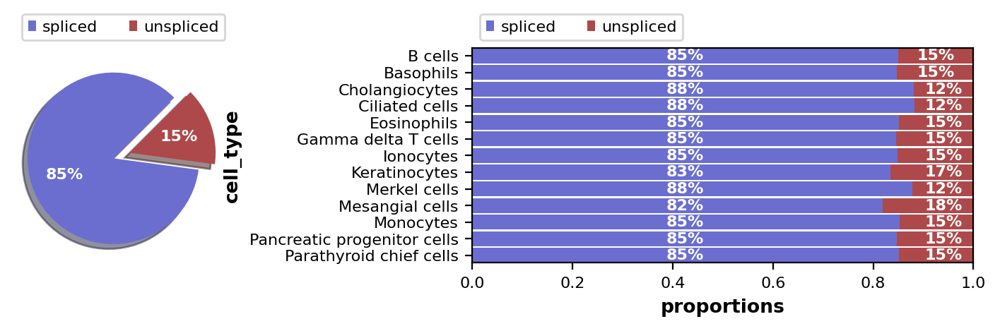

In [10]:
scv.pl.proportions(adata, groupby="cell_type")

Here, the proportions of spliced/unspliced counts are displayed. Depending on the protocol used (Drop-Seq, Smart-Seq, inDrop and 10x Genomics Chromium protocols), we typically have between 10%-25% of unspliced molecules containing intronic sequences. We also advice you to examine the variations on cluster level to verify consistency in splicing efficiency. Here, we find variations, with slightly **lower** unspliced proportions at **Ciliated & Merkels cells**, then ***higher proportion*** at ***Mesangial & Keratinocytes cells***.

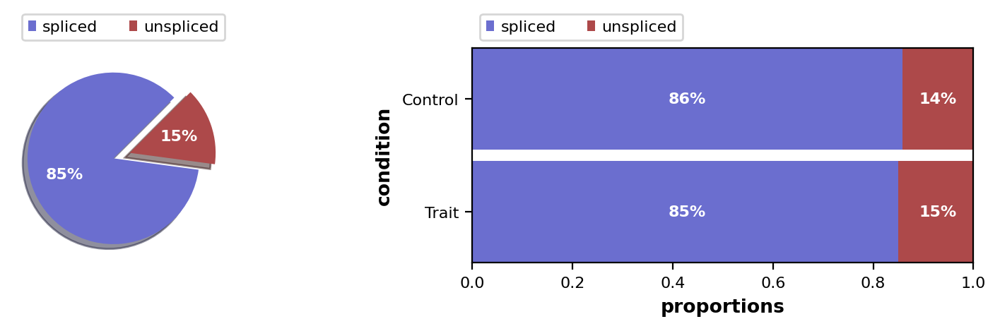

In [11]:
scv.pl.proportions(adata, groupby="condition")

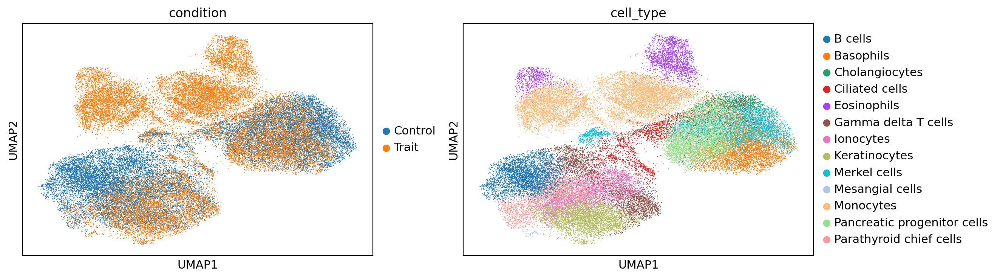

In [12]:
sc.pl.embedding(adata, basis="umap", color=["condition", "cell_type"])

## Estimate RNA velocity

RNA velocity estimation can currently be tackled with three existing approaches:

• steady-state / deterministic model (using steady-state residuals)

• stochastic model (using second-order moments),

• dynamical model (using a likelihood-based framework).

 + **The steady-state / deterministic model:**, as being used in velocyto, estimates velocities as follows: Under the assumption that transcriptional phases (induction and repression) last sufficiently long to reach a steady-state equilibrium (active and inactive),**`velocities are quantified as the deviation of the observed ratio from its steady-state ratio`**. The equilibrium mRNA levels are approximated with a linear regression on the presumed steady states in the lower and upper quantiles. This simplification makes two fundamental assumptions: a common splicing rate across genes and steady-state mRNA levels to be reflected in the data. It can lead to errors in velocity estimates and cellular states as the assumptions are often violated, in particular when a population comprises multiple heterogeneous subpopulation dynamics.


 + **The stochastic model:** aims to better capture the steady states. By treating transcription, splicing and degradation as probabilistic events, the resulting Markov process is approximated by moment equations. By including secondorder moments, **`it exploits not only the balance of unspliced to spliced mRNA levels but also their covariation`**. It has been demonstrated on the endocrine pancreas that stochasticity adds valuable information, overall yielding higher consistency than the deterministic model, while remaining as efficient in computation time.


 + **The dynamical model:** (most powerful while computationally most expensive) solves the full dynamics of splicing kinetics for each gene. **`It thereby adapts RNA velocity to widely varying specifications such as non-stationary populations, as does not rely on the restrictions of a common splicing rate or steady states to be sampled`**.
 
     The splicing dynamics 
     
     `𝑑𝑢(𝑡)/𝑑𝑡 = 𝛼𝑘(𝑡) − 𝛽𝑢(𝑡), (4.1)` 
     
     `𝑑𝑠(𝑡)/𝑑𝑡 = 𝛽𝑢(𝑡) − 𝛾𝑠(4.2) (𝑡)`,
     
     is solved in a likelihood-based expectation-maximization framework, **`by iteratively estimating the parameters of reaction rates and latent cell-specific variables`**, i.e. transcriptional state k and cell-internal latent time t.It thereby aims to learn the unspliced/spliced phase trajectory. Four transcriptional states are modeled to account for all possible configurations of gene activity: two dynamic transient states (induction and repression) and two steady states (active and inactive) potentially reached after each dynamic transition.

In [13]:
scv.pp.filter_genes(adata, min_shared_counts=20)
scv.pp.normalize_per_cell(adata)
scv.pp.filter_genes_dispersion(adata, n_top_genes=2000)
scv.pp.log1p(adata)

Filtered out 119 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.


In [14]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 8 genes that are detected 20 counts (shared).
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
computing neighbors
    finished (0:00:16) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [16]:
scv.tl.recover_dynamics(adata)

In [17]:
scv.tl.velocity(adata, mode='dynamical', n_jobs=4)
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/46110 [00:00<?, ?cells/s]

    finished (0:00:57) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [18]:
adata.write('/home/aruna/Desktop/Analysis/Project1/Data/Project1&DynVelo.h5ad', compression='gzip')

In [3]:
adata = scv.read('/home/aruna/Desktop/Analysis/Project1/Data/Project1&DynVelo.h5ad', cache=True)

In [4]:
adata

AnnData object with n_obs × n_vars = 46110 × 1102
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'batch_colors', 'cell_type_colors', 'c

465 1102


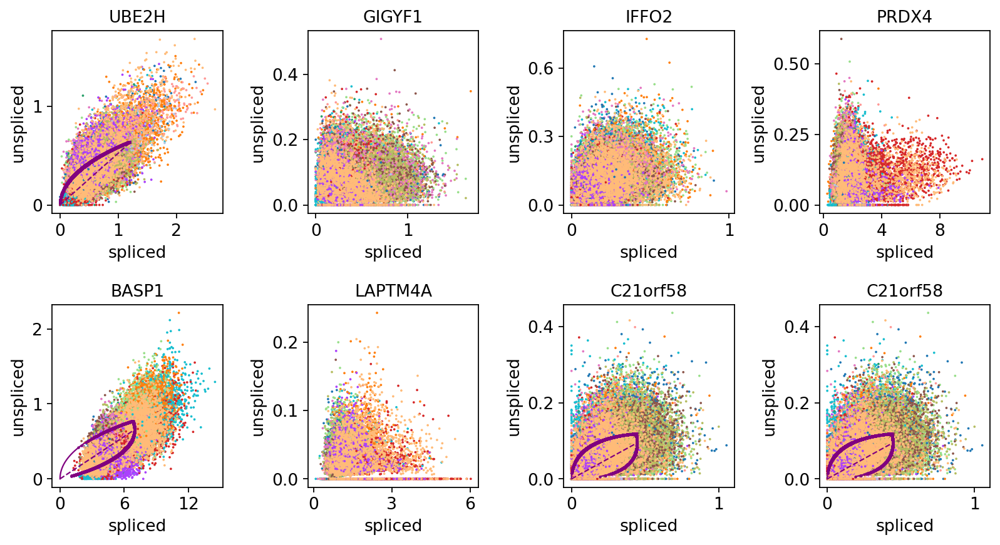

In [55]:
print(adata.var['velocity_genes'].sum(), adata.n_vars)
top_genes = adata.var_names[adata.var.fit_likelihood.argsort()[::-1]]
scv.pl.scatter(adata, basis=top_genes[:10], ncols=4, color='cell_type', wspace=.5, hspace=.5)

There are 465 genes being used and 1102 cells.

## Project the velocities

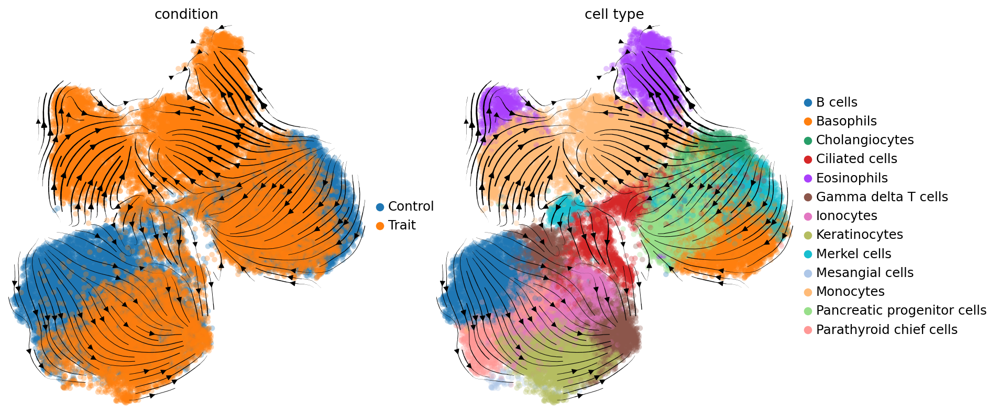

In [56]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color=['condition','cell_type'], 
                                 legend_loc='right margin')

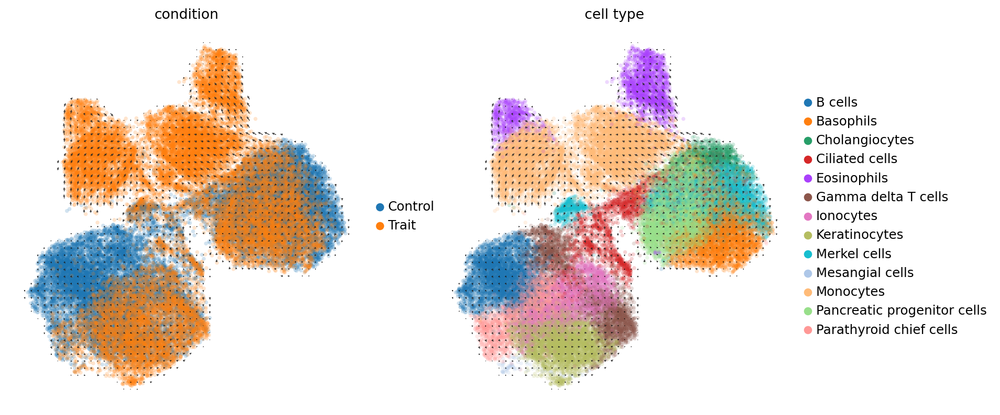

In [57]:
scv.pl.velocity_embedding_grid(adata, basis='umap', color=['condition', 'cell_type'], 
                          legend_loc='right margin')

## Interprete the velocities

See the gif <a href="https://user-images.githubusercontent.com/31883718/80227452-eb822480-864d-11ea-9399-56886c5e2785.gif">here</a> to get an idea of how to interpret a spliced vs. unspliced phase portrait. Gene activity is orchestrated by transcriptional regulation. Transcriptional induction for a particular gene results in an **increase of (newly transcribed) precursor unspliced mRNAs** while, conversely, repression or absence of transcription results in a **decrease of unspliced mRNAs**. Spliced mRNAs is produced from unspliced mRNA and follows the same trend with a time lag. Time is a hidden/latent variable. Thus, the dynamics needs to be inferred from what is actually measured: spliced and unspliced mRNAs as displayed in the phase portrait.

In [54]:
adata

AnnData object with n_obs × n_vars = 46110 × 1102
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'batch_colors', 'cell_type_colors', 'c

In [84]:
df = scv.get_df(adata, 'rank_genes_groups/names')
df.head(10)

,0
0,HNRNPH1
1,CTNNB1
2,SET
3,YWHAE
4,EIF5A
5,PPP1CB
6,B4GALT1
7,CALR
8,CDC42
9,EIF2S3


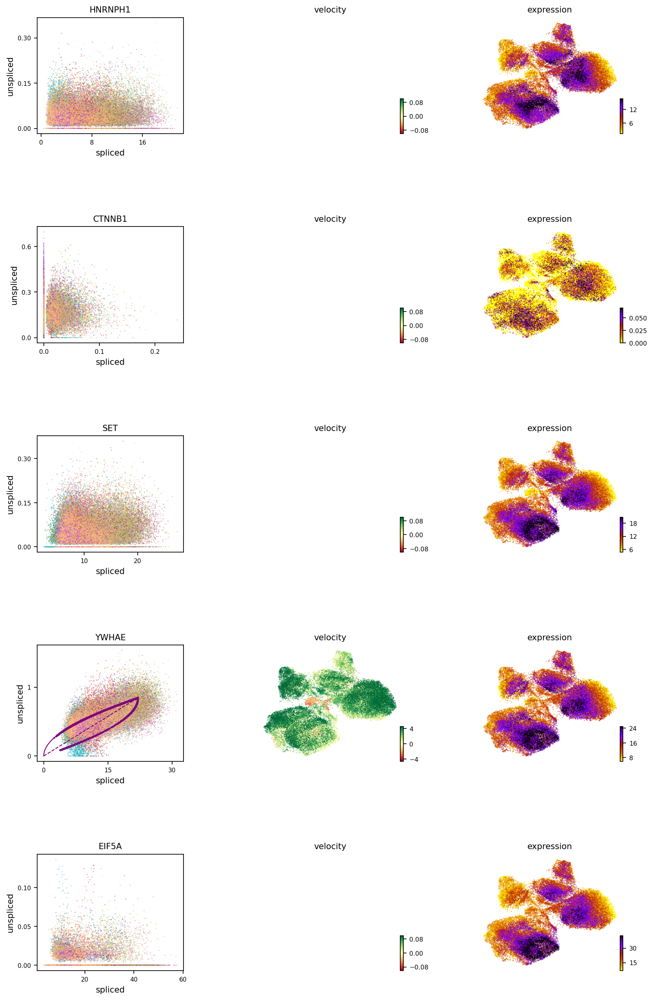

In [74]:
scv.pl.velocity(adata, ['HNRNPH1',  'CTNNB1', 'SET', 'YWHAE', 'EIF5A'], color='cell_type')

## Identify important genes
 
 + **By Cell type**

In [95]:
scv.tl.rank_velocity_genes(adata, groupby='cell_type', min_corr=.3)

df = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:03) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,B cells,Basophils,Cholangiocytes,Ciliated cells,Eosinophils,Gamma delta T cells,Ionocytes,Keratinocytes,Merkel cells,Mesangial cells,Monocytes,Pancreatic progenitor cells,Parathyroid chief cells
0,PLSCR1,DDX60L,MFGE8,UBB,TRIM21,PIF1,EPHX1,DDX3Y,EIF2S3,MYL6,TRIM21,LGALS3BP,PDLIM7
1,EIF2AK2,RNF213,IGFBP4,NCL,NLRC5,DMKN,DMKN,CDC20,KDSR,AVPI1,IFIT1,KDSR,DMKN
2,DMKN,ARHGAP29,SCD,SNRPD1,PSMB9,TESC,TPD52L1,PDLIM7,ANKRD29,NDRG1,OPTN,MYLK,PLEK2
3,NDRG1,PRKD2,TRIM56,SNRPB,CXXC5,VCAN,ULK1,RSPO3,MYLK,APOC1,LAP3,AKR1C3,CDA
4,F2RL1,PARP14,FOSL2,MYL6,CRIP1,BASP1,SLC7A11,RPS6KA5,SLC12A2,EIF1AY,C15orf48,LAMB1,EIF1AY
5,RSPO3,DTX3L,PPP1R14A,PPP1R14A,LAP3,LMO7,RSPO3,DMKN,CALR,NCOA3,PSMB9,PLSCR1,RSPO3
6,DPYSL3,RIPK2,TBX3,SSBP1,C15orf48,GPRC5A,OGFR,SLC25A28,TRIM56,LYPD1,CD38,DCBLD2,EPHX1
7,TPD52L1,PLSCR1,KDSR,HSP90B1,ZC3HAV1,DDX3Y,FA2H,VCAN,SLC3A2,RIPK2,CCND3,IFI35,NDRG1
8,SEMA3A,ZNFX1,NUAK1,PSMB3,IRS2,SMIM14,VCAN,NCOA3,MMD,COL5A2,MAP3K8,RNF213,NCEH1
9,EIF1AY,NLRC5,HSPG2,MGLL,DTX3L,PAPPA,COL4A1,SEMA3A,C21orf58,SULT2B1,CRIP1,SULT2B1,KLF7


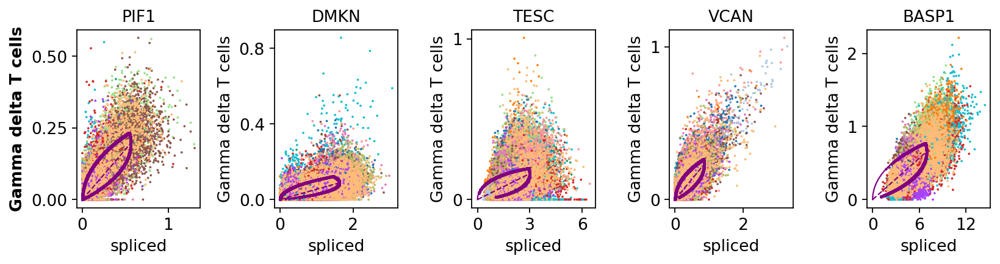

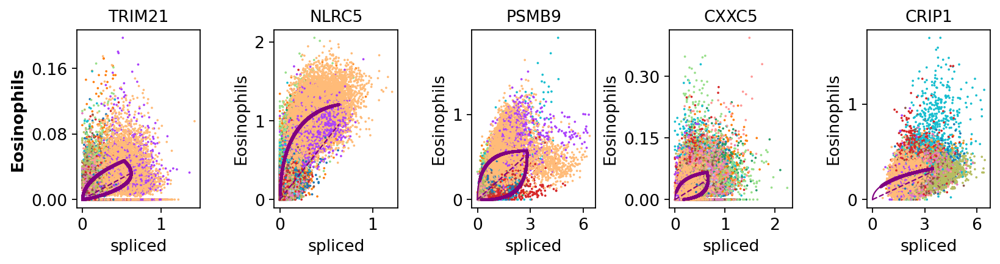

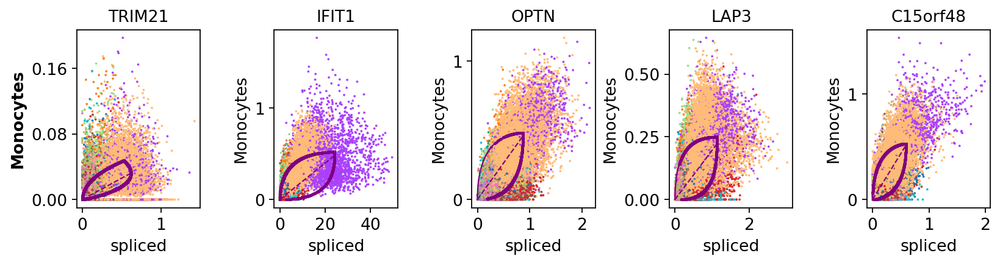

In [88]:
for cell_type in ['Gamma delta T cells', 'Eosinophils', 'Monocytes']:
    scv.pl.scatter(adata, df[cell_type][:5], ylabel=cell_type, color='cell_type', wspace=.6)

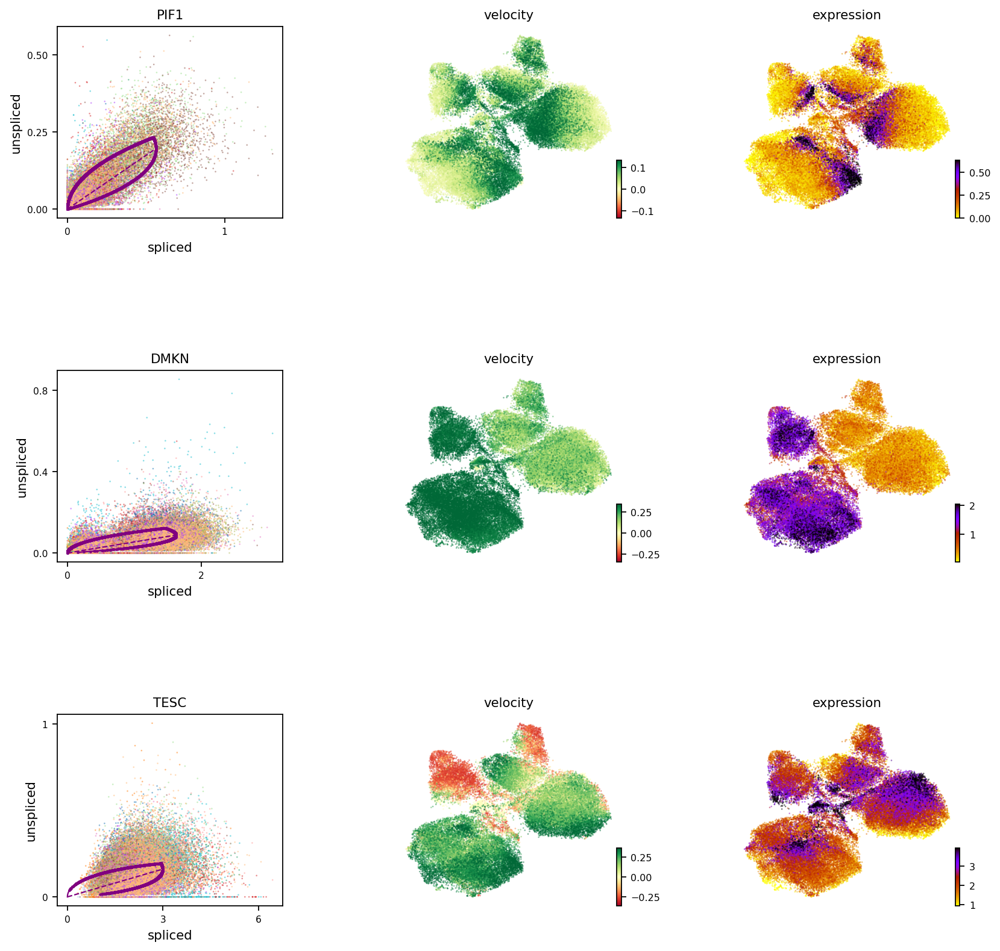

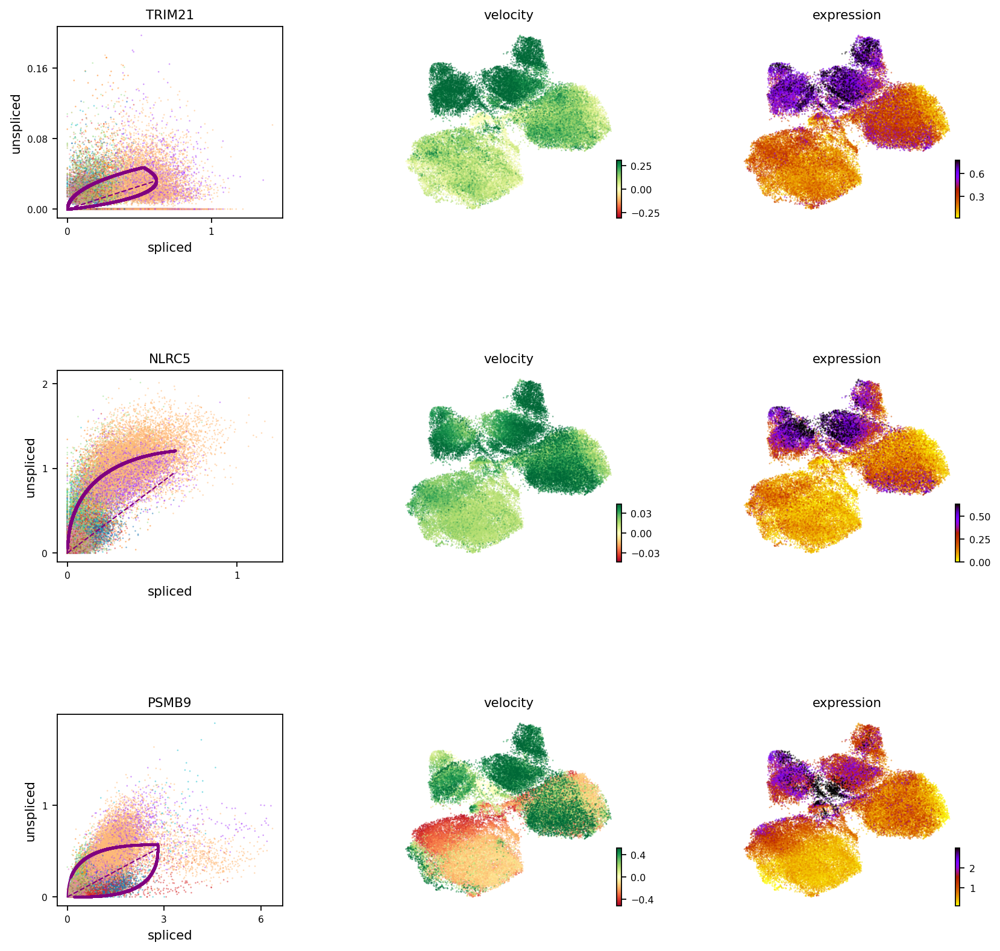

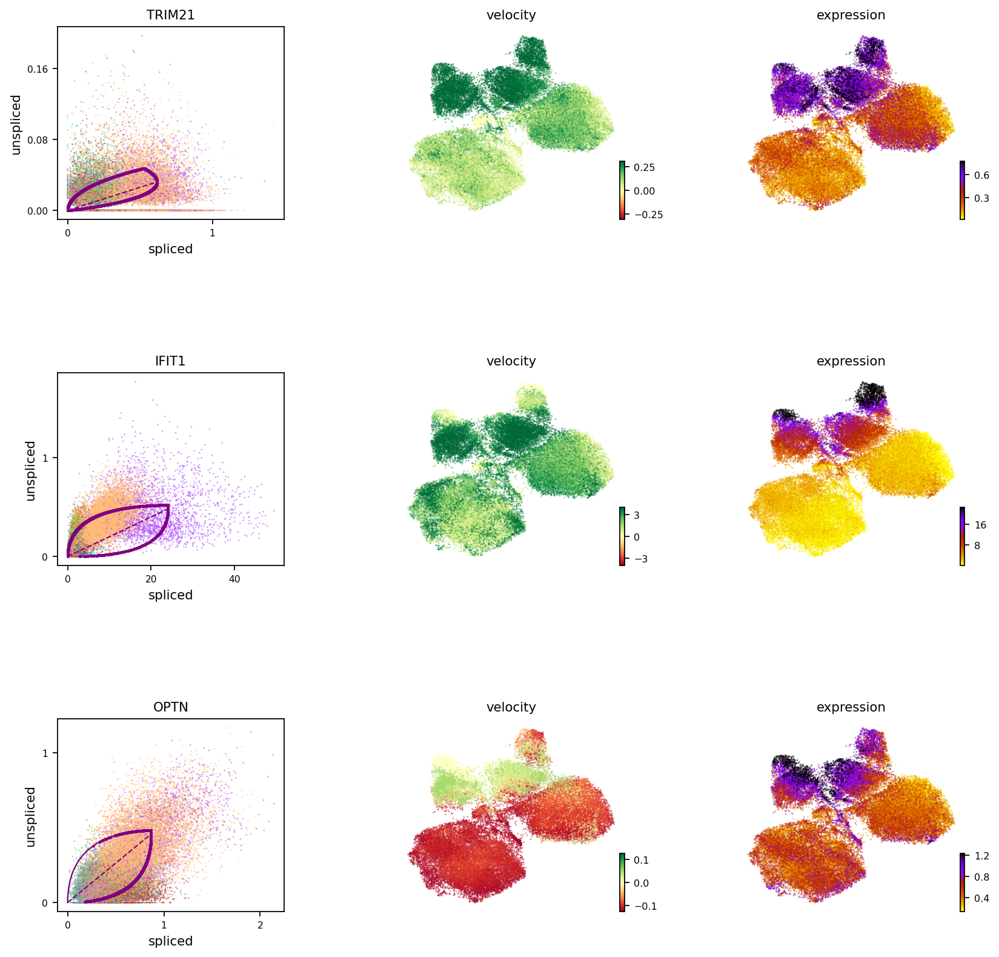

In [89]:
for cell_type in ['Gamma delta T cells', 'Eosinophils', 'Monocytes']:
    scv.pl.velocity(adata, df[cell_type][:3], color='cell_type')

+ **By Condition**

In [90]:
scv.tl.rank_velocity_genes(adata, groupby='condition', min_corr=.3)

df = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,Control,Trait
0,NUAK2,LAP3
1,CASP7,PSMB9
2,STRA6,TRIM21
3,TPD52L1,ISG20
4,HELZ2,NLRC5
5,PLSCR1,C15orf48
6,SLC25A28,OAS2
7,EPHX1,OPTN
8,IL15,IFI35
9,SPOCK1,SAMHD1


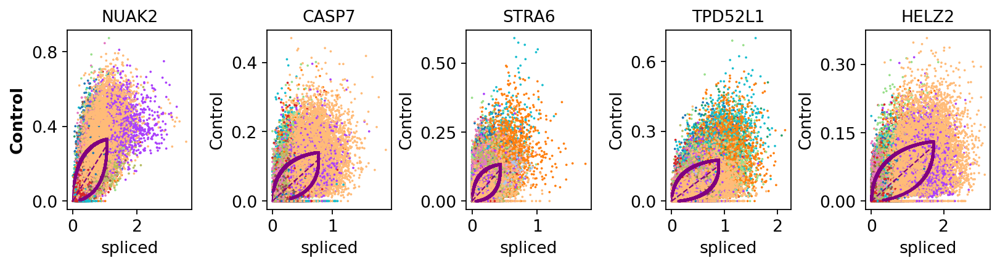

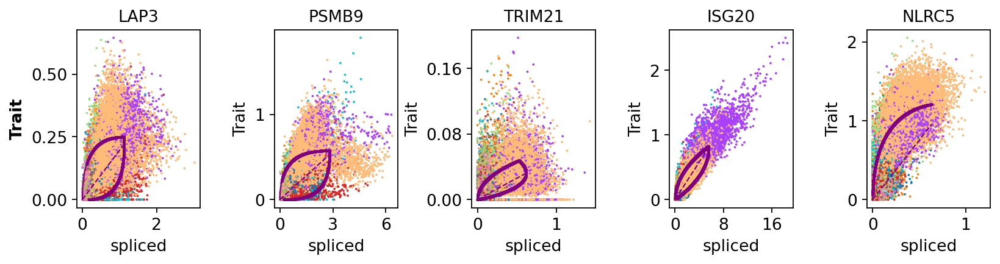

In [92]:
for condition in ['Control', 'Trait']:
    scv.pl.scatter(adata, df[condition][:5], ylabel=condition, color='cell_type', wspace=.6)

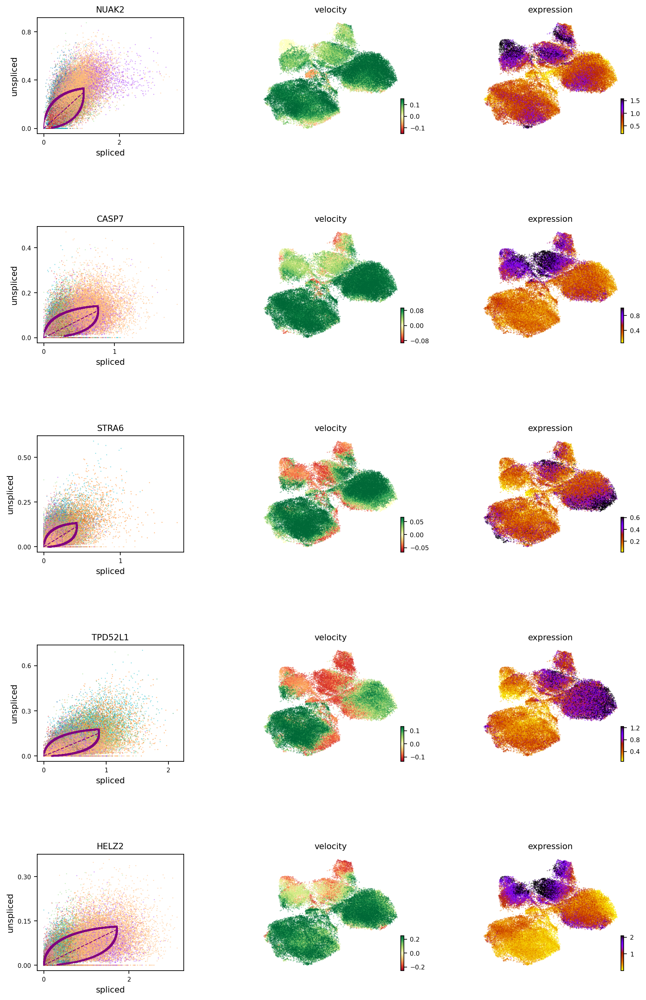

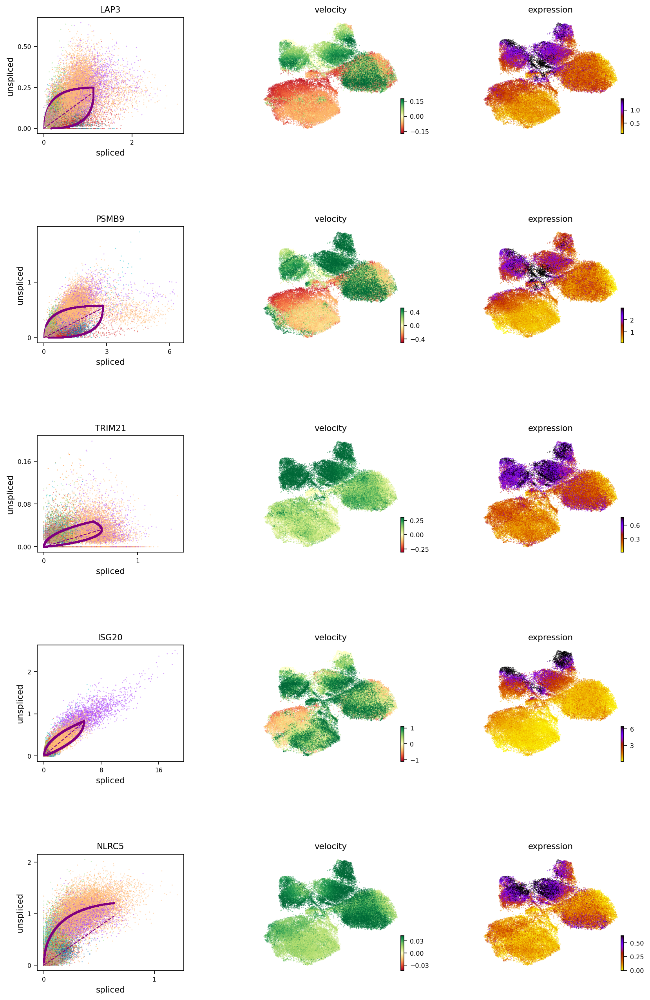

In [94]:
for condition in ['Control', 'Trait']:
    scv.pl.velocity(adata, df[condition][:5], color='cell_type')

## Speed and coherence

Two more useful stats: - The speed or rate of differentiation is given by the length of the velocity vector. - The coherence of the vector field (i.e., how a velocity vector correlates with its neighboring velocities) provides a measure of confidence.

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


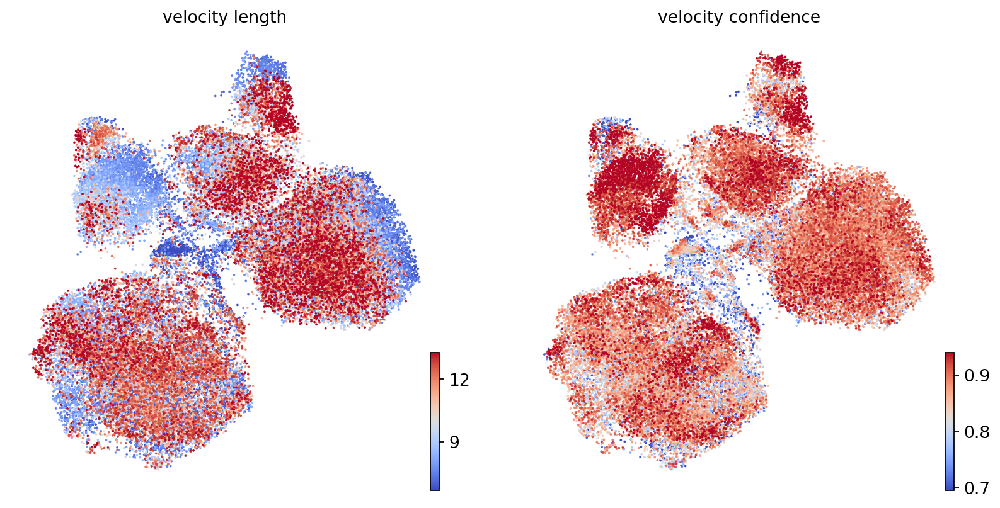

In [19]:
scv.tl.velocity_confidence(adata)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95])

In [20]:
df = adata.obs.groupby('cell_type')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

cell_type,B cells,Basophils,Cholangiocytes,Ciliated cells,Eosinophils,Gamma delta T cells,Ionocytes,Keratinocytes,Merkel cells,Mesangial cells,Monocytes,Pancreatic progenitor cells,Parathyroid chief cells
velocity_length,9.816980,10.213184,9.200196,9.103175,10.341850,9.662992,9.965525,9.179878,8.436419,10.732821,9.416450,10.338098,9.709996
velocity_confidence,0.843679,0.852764,0.851790,0.785651,0.845935,0.824034,0.837549,0.826001,0.850492,0.842678,0.882559,0.846927,0.823195


In [21]:
df = adata.obs.groupby('condition')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

condition,Control,Trait
velocity_length,9.405773,9.794776
velocity_confidence,0.837093,0.854158


## Velocity graph and pseudotime

We can visualize the velocity graph to portray all velocity-inferred cell-to-cell connections/transitions. It can be confined to high-probability transitions by setting a threshold. 

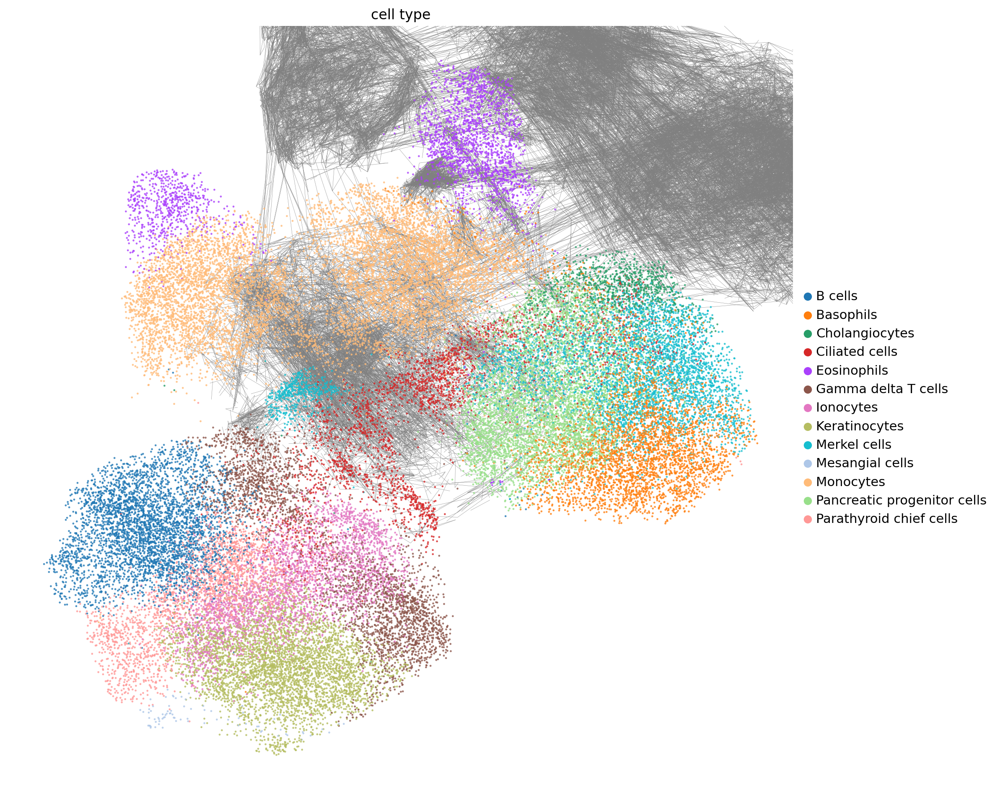

In [22]:
scv.pl.velocity_graph(adata, threshold=.5, color='cell_type', 
                          legend_loc='right margin', ncols=1)

In [23]:
#x, y = scv.utils.get_cell_transitions(adata, basis='umap', n_neighbors=10, starting_cell=70)
#ax = scv.pl.velocity_graph(adata, c='lightgrey', edge_width=.05, show=False)
#ax = scv.pl.scatter(adata, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

Finally, based on the velocity graph, a velocity pseudotime can be computed. After inferring a distribution over root cells from the graph, it measures the average number of steps it takes to reach a cell after walking along the graph starting from the root cells.

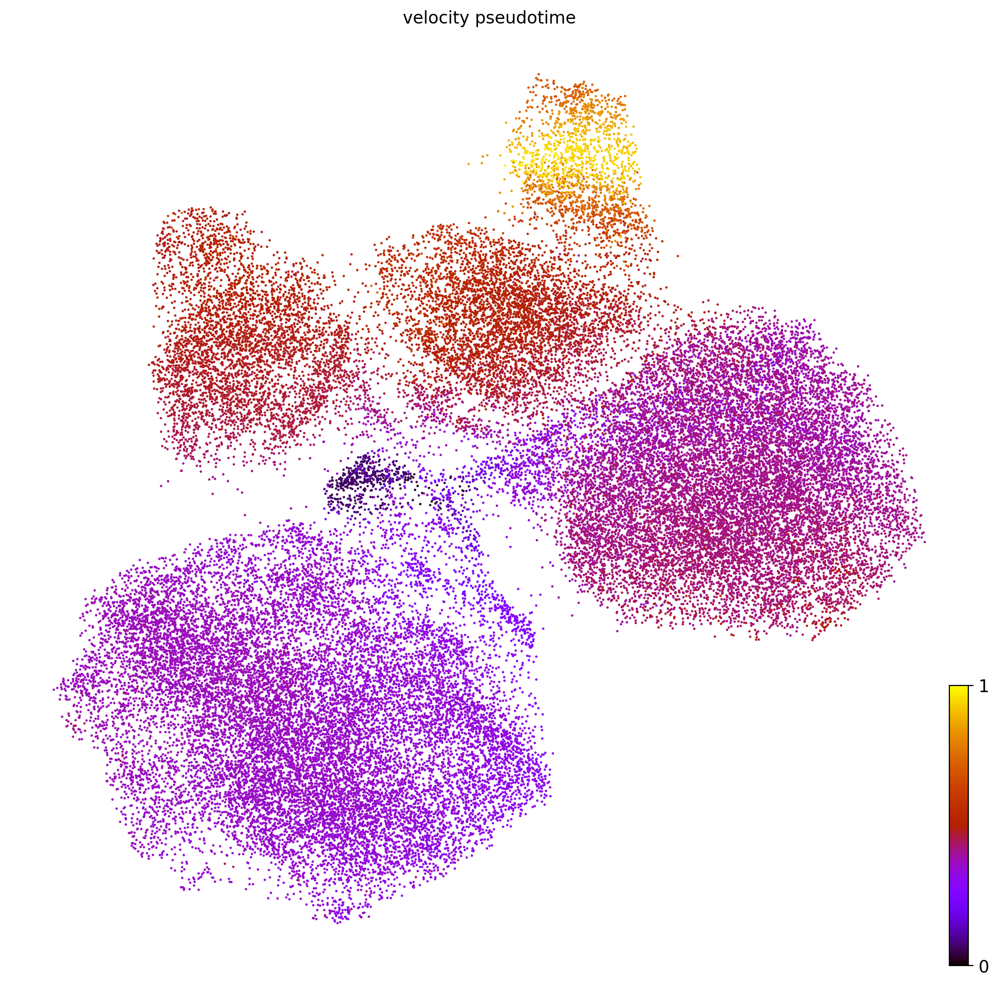

In [24]:
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime', cmap='gnuplot')

## PAGA velocity graph

PAGA graph abstraction has benchmarked as top-performing method for trajectory inference. It provides a graph-like map of the data topology with weighted edges corresponding to the connectivity between two clusters. Here, PAGA is extended by velocity-inferred directionality.

In [84]:
adata

AnnData object with n_obs × n_vars = 46110 × 1102
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'condition', 'cell_type', 'sample_batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'batch_colors', 'cell_type_colors', 'c

In [45]:
# PAGA requires to install igraph, if not done yet.
!pip install python-igraph --upgrade --quiet

In [27]:
# this is needed due to a current bug - bugfix is coming soon.
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']

scv.tl.paga(adata, groups='cell_type', use_time_prior=False)
df = scv.get_df(adata, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA 
    finished (0:00:03) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,B cells,Basophils,Cholangiocytes,Ciliated cells,Eosinophils,Gamma delta T cells,Ionocytes,Keratinocytes,Merkel cells,Mesangial cells,Monocytes,Pancreatic progenitor cells,Parathyroid chief cells
B cells,0,0,0,0,0,0,0,0.46,0,0,0,0,0
Basophils,0,0,0,0,0,0,0,0,0,0,0.43,0,0
Cholangiocytes,0,0,0,0.025,0,0,0,0,0,0,0,0.32,0
Ciliated cells,0,0,0,0,0,0.16,0,0,0,0,0,0,0
Eosinophils,0,0,0,0,0,0,0,0,0,0,0.31,0,0
Gamma delta T cells,0,0,0,0,0,0,0,0,0,0,0,0,0
Ionocytes,0,0,0,0,0,0,0,0,0,0,0,0,0
Keratinocytes,0,0,0,0,0,0.22,0,0,0,0,0,0,0
Merkel cells,0,0.23,0,0,0,0,0,0,0,0,0,0,0
Mesangial cells,0,0,0,0,0,0,0,0.21,0,0,0,0,0


This reads from left/row to right/column, thus e.g. assigning a confident transition from Merkel sells to Basophils.

This table can be summarized by a directed graph superimposed onto the UMAP embedding.

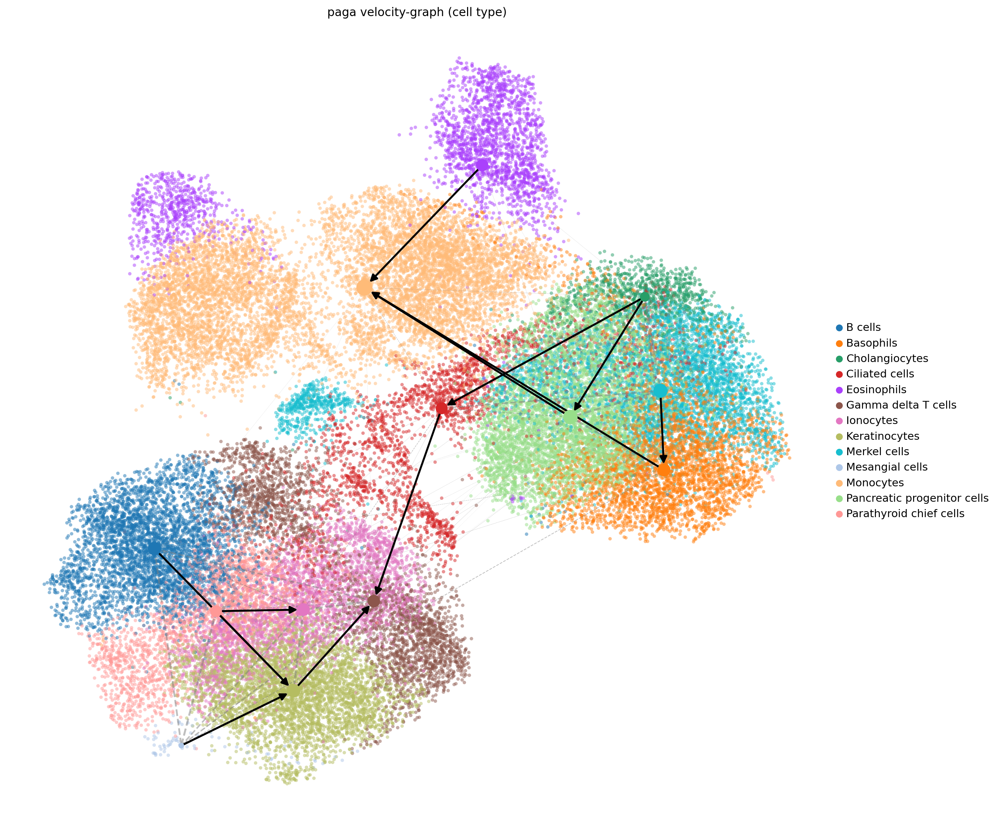

In [39]:
scv.pl.paga(adata, basis='umap', size=50, alpha=.5, 
            min_edge_width=2, node_size_scale=1)

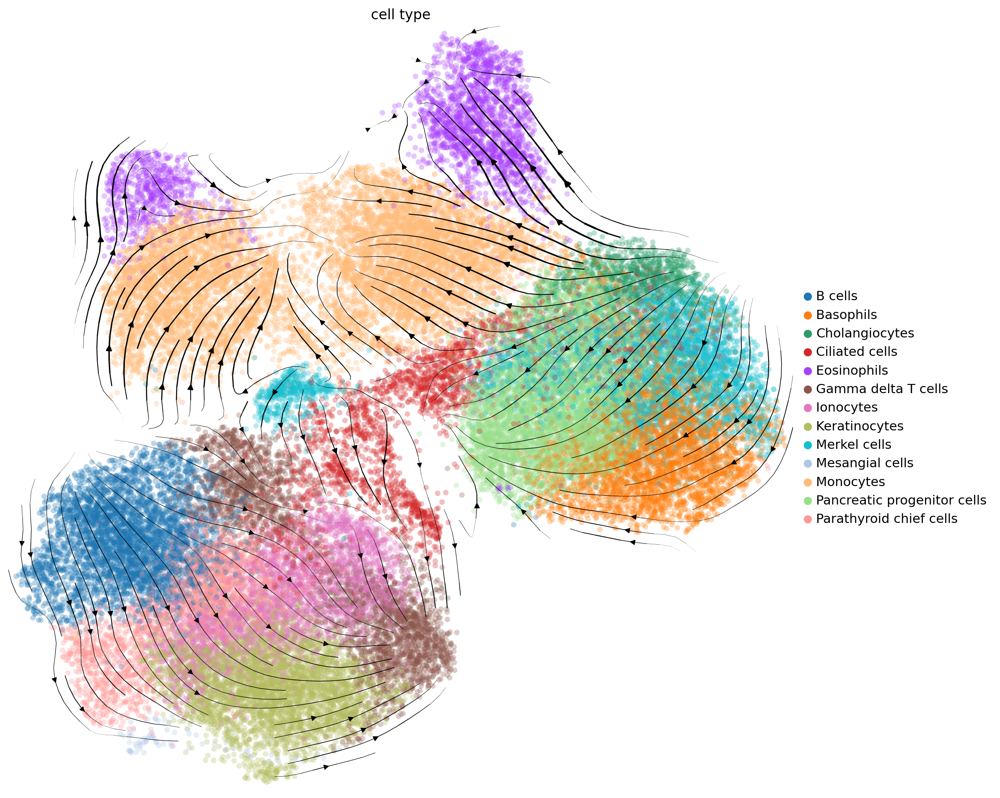

In [40]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color='cell_type', 
                                 legend_loc='right margin', ncols=1)

Here we observb **2** main velocity direction, one in **Gamma delta T cells and Monocytes**. 

In [43]:
results_file = '/home/aruna/Desktop/Analysis/Project1/Data/Project1&DynVelo.h5ad'  
adata.write(results_file)

## Some more analysis for dynamical mode

### Kinetic rate paramters

The rates of RNA transcription, splicing and degradation are estimated without the need of any experimental data.

They can be useful to better understand the cell identity and phenotypic heterogeneity.

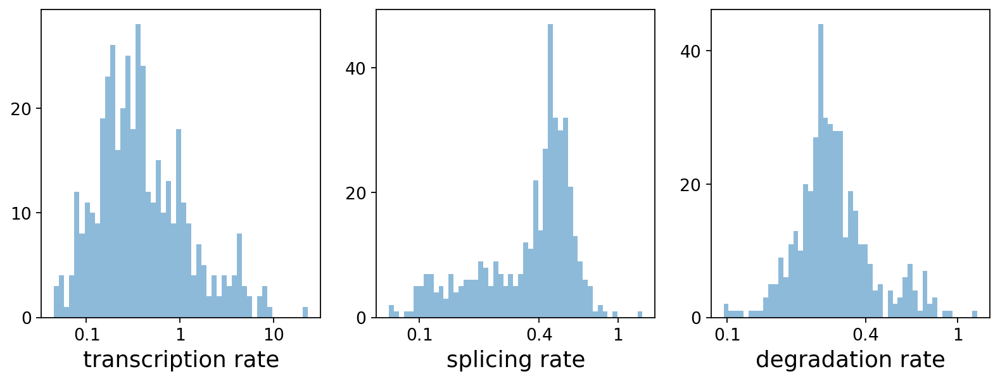

,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
SAMD11,0.12,0.34,3.22,0.21,10.09,0.11,0.03,0.32,1.86e-01,0.0,0.0,0.45,0.10,1.03,1.17,2.89
DHRS3,0.39,0.19,0.32,0.17,20.01,0.36,0.19,0.24,2.55e-01,0.0,0.0,0.35,0.52,0.72,0.68,3.70
PADI2,0.22,0.23,1.60,0.29,4.71,0.34,0.03,0.11,1.31e-47,0.0,0.0,0.47,0.12,0.45,2.14,1.89
CDA,0.22,0.42,5.31,0.38,8.99,0.10,0.03,0.30,1.58e-01,0.0,0.0,0.45,0.09,0.94,1.43,1.93
RAP1GAP,0.12,0.24,2.36,0.24,5.83,0.20,0.03,0.17,1.33e-01,0.0,0.0,0.45,0.09,0.58,1.72,2.36


In [44]:
df = adata.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata, 'fit*', dropna=True).head()

The estimated gene-specific parameters comprise rates of transription (fit_alpha), splicing (fit_beta), degradation (fit_gamma), switching time point (fit_t_), a scaling parameter to adjust for under-represented unspliced reads (fit_scaling), standard deviation of unspliced and spliced reads (fit_std_u, fit_std_s), the gene likelihood (fit_likelihood), inferred steady-state levels (fit_steady_u, fit_steady_s) with their corresponding p-values (fit_pval_steady_u, fit_pval_steady_s), the overall model variance (fit_variance), and a scaling factor to align the gene-wise latent times to a universal, gene-shared latent time (fit_alignment_scaling).



### Latent time

The dynamical model recovers the latent time of the underlying cellular processes. This latent time represents the cell’s internal clock and approximates the real time experienced by cells as they differentiate, based only on its transcriptional dynamics.

computing latent time using root_cells as prior
    finished (0:00:09) --> added 
    'latent_time', shared time (adata.obs)


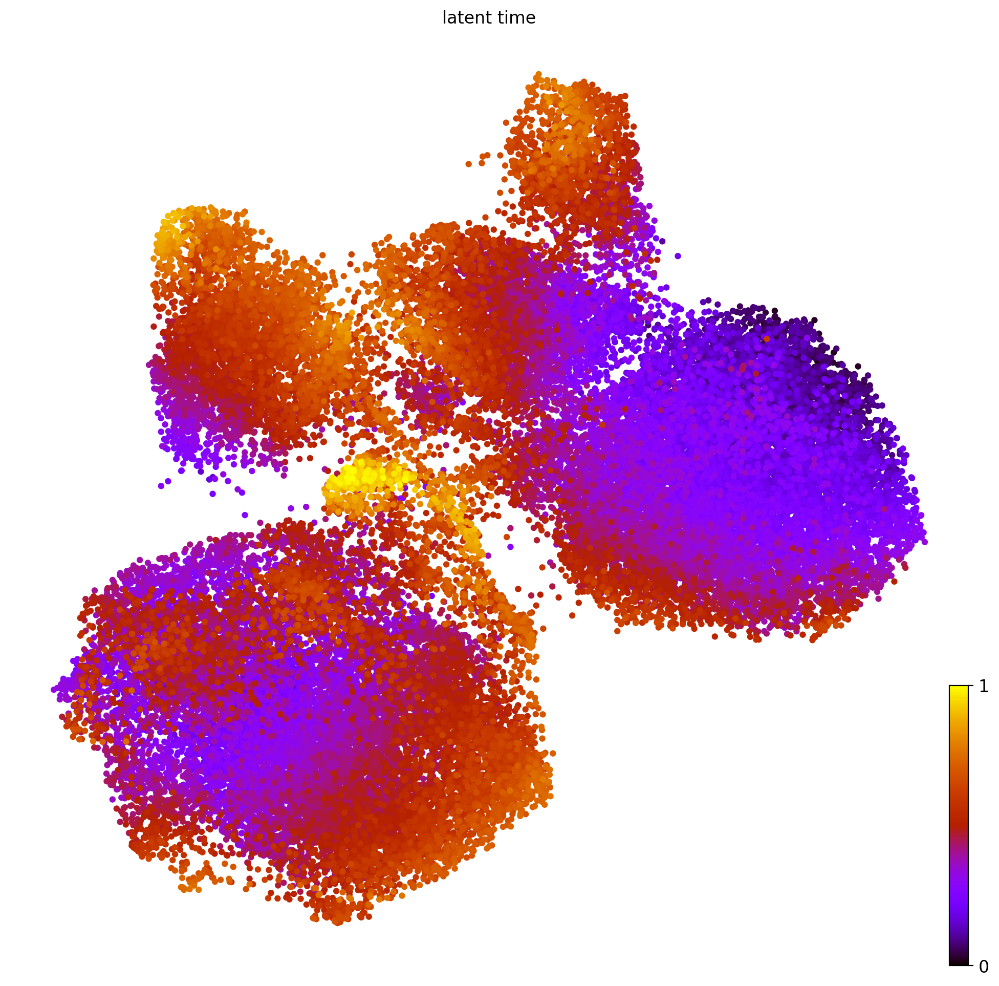

In [45]:
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80)

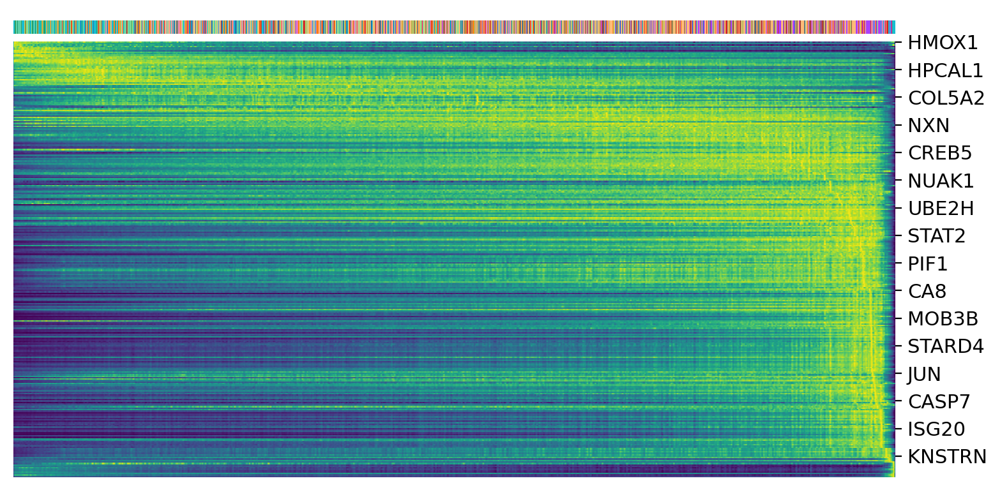

In [46]:
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(adata, var_names=top_genes, sortby='latent_time', col_color='cell_type', n_convolve=100)

### Top-likelihood genes

Driver genes display pronounced dynamic behavior and are systematically detected via their characterization by high likelihoods in the dynamic model.

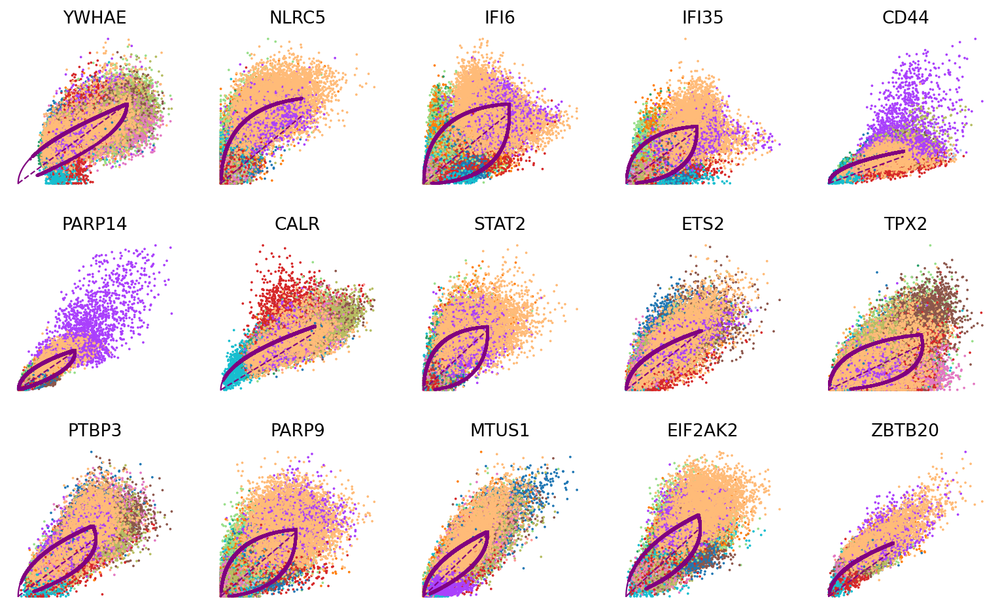

In [47]:
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:15], ncols=5, frameon=False, color='cell_type')

### Cluster-specific top-likelihood genes

Moreover, partial gene likelihoods can be computed for a each cluster of cells to enable cluster-specific identification of potential drivers.

In [58]:
scv.tl.rank_dynamical_genes(adata, groupby='cell_type')
df = scv.get_df(adata, 'rank_dynamical_genes/names')
df.head(10)

ranking genes by cluster-specific likelihoods
    finished (0:00:09) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,B cells,Basophils,Cholangiocytes,Ciliated cells,Eosinophils,Gamma delta T cells,Ionocytes,Keratinocytes,Merkel cells,Mesangial cells,Monocytes,Pancreatic progenitor cells,Parathyroid chief cells
0,YWHAE,YWHAE,CALR,TPX2,IFI6,YWHAE,YWHAE,YWHAE,CALR,YWHAE,YWHAE,YWHAE,YWHAE
1,CALR,CALR,DCBLD2,KCNMA1,EIF2AK2,ANTXR1,FOSL1,TOP2A,YWHAE,CALR,IFI6,CALR,CALR
2,DCBLD2,TPX2,YWHAE,NXN,STAT1,HPCAL1,CALR,ADAR,DCBLD2,FLNB,CALR,PARP9,FOSL1
3,TOP2A,PLSCR1,CYP24A1,CYP24A1,NLRC5,HPGD,ETS2,ETS2,ZFP36L1,AXL,NLRC5,TOP2A,KCNMA1
4,ANTXR1,DCBLD2,HPGD,MFHAS1,YWHAE,BICC1,MTUS1,TPX2,HPGD,TOP2A,TPX2,HPGD,ADAR
5,TPX2,DTX3L,EGFR,ANTXR1,TPX2,RSPO3,ITGA2,RSPO3,PTPRF,HPCAL1,DDX60L,EGFR,RSPO3
6,CYP24A1,PARP9,ARHGAP26,KIF14,STAT2,LMCD1,ADAR,HPCAL1,EVA1C,LAMB1,PLSCR1,ZBTB20,EGFR
7,ZFP36L1,MFHAS1,MAP1B,LIMCH1,PNPT1,CALR,ZBTB20,FLNB,CYP24A1,MCM10,MFHAS1,MTUS1,ITGA2
8,HPCAL1,EGFR,LIMCH1,GTSE1,CALR,MAP1B,DCBLD2,ZBTB20,KCNMA1,BICC1,EGFR,HMGA2,MAP1B
9,RSPO3,EIF2S3,HIPK2,ZFP36L1,EVA1C,ZBTB20,HPCAL1,LYPD1,HELLS,RSPO3,TOP2A,AXL,CYP24A1


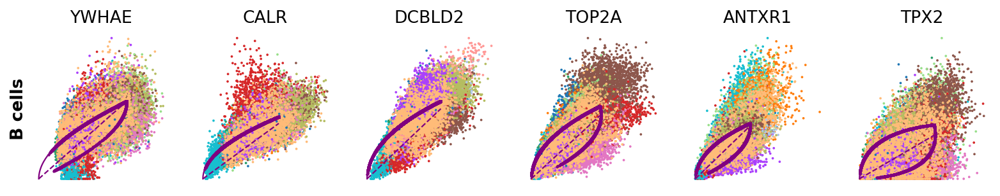

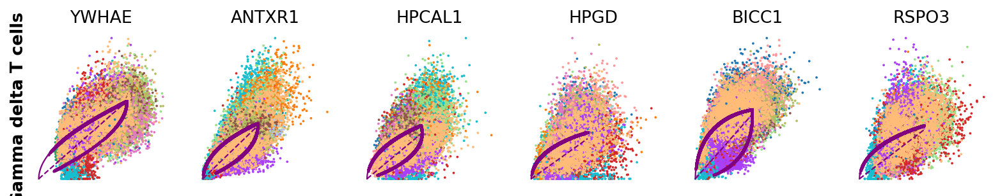

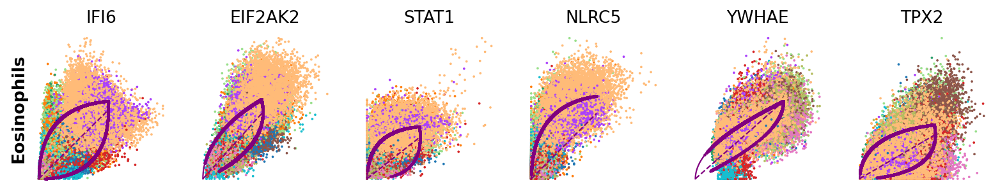

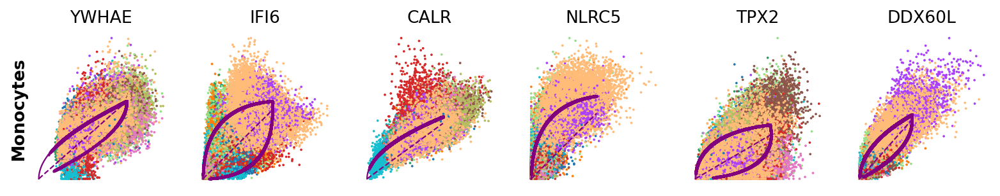

In [59]:
for cell_type in ['B cells', 'Gamma delta T cells', 'Eosinophils', 'Monocytes']:
    scv.pl.scatter(adata, df[cell_type][:6], ylabel=cell_type, frameon=False, color='cell_type')

In [112]:
scv.tl.rank_dynamical_genes(adata, groupby='condition')
df = scv.get_df(adata, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:00:09) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,Control,Trait
0,YWHAE,YWHAE
1,CALR,IFI6
2,EVA1C,NLRC5
3,ZFP36L1,EIF2AK2
4,ZBTB20,TPX2


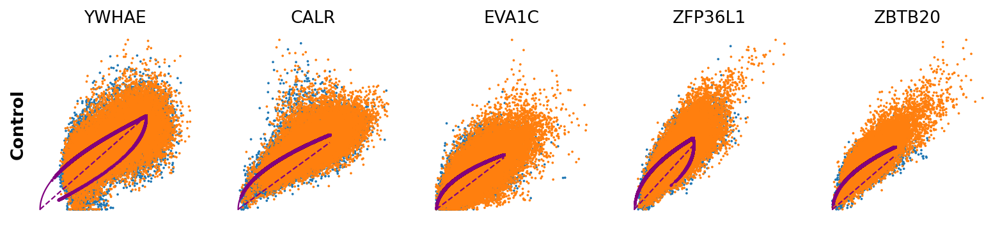

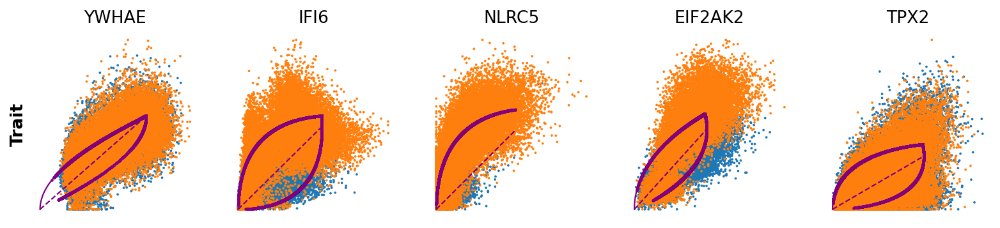

In [113]:
for condition in ['Control', 'Trait']:
    scv.pl.scatter(adata, df[condition][:5], ylabel=condition, frameon=False, color='condition')